# Outline

## This project will helps to extract text content from the pdf or image data
(Libraries used - PyPDF, PyTesseract, EasyOCR, LangChain)


1. Import Libraries
2. Functions to convert PDF to image data and to display content
3. Use python libraries to extract data from the image

## 1. Import Libraries

In [1]:
! pip install -U pypdfium2

In [2]:
import pypdfium2 as pdfium
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

## 2. Functions to convert pdf into image data

In [4]:
def pdf_to_image(pdf_path, scale=300/72):

  # reading the content using PdfDocument
  pdf_file = pdfium.PdfDocument(pdf_path)

  page_indices = [i for i in range(len(pdf_file))]

  # We want to display the content of the pdf, for that we need to first convert
  # the pdf into image with renderer
  renderer = pdf_file.render(
        pdfium.PdfBitmap.to_pil,
        page_indices = page_indices,
        scale = scale,
    )

  # Final list which contains dictionary of page contents with their indexies
  final_list = []

  for i, image in zip(page_indices, renderer):

    image_byte_array = BytesIO()
    image.save(image_byte_array, format='jpeg', optimize=True)
    image_byte_array = image_byte_array.getvalue()
    final_list.append(dict({i:image_byte_array}))

  return final_list

## 3. Function to display_image

In [21]:
def display_image(list_of_images):

  all_images = [list(data.values())[0] for data in list_of_images]

  # print(f'Total number of images: {len(all_images)}')
  # print(all_images.values())

  for index, image_bytes in enumerate(all_images):
    image = Image.open(BytesIO(image_bytes))
    figure = plt.figure(figsize= (image.width / 100, image.height / 100))
    plt.title(f'Image {index + 1}')
    plt.axis('off')
    plt.imshow(image)
    plt.axis('off')
    plt.show()

## 4. Let's load the data and do testing

In [17]:
pdf_to_image_var = pdf_to_image("/content/Kedar 250 words list.pdf")

In [18]:
print(pdf_to_image_var)

[{0: b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x08\x06\x06\x07\x06\x05\x08\x07\x07\x07\t\t\x08\n\x0c\x14\r\x0c\x0b\x0b\x0c\x19\x12\x13\x0f\x14\x1d\x1a\x1f\x1e\x1d\x1a\x1c\x1c $.\' ",#\x1c\x1c(7),01444\x1f\'9=82<.342\xff\xdb\x00C\x01\t\t\t\x0c\x0b\x0c\x18\r\r\x182!\x1c!22222222222222222222222222222222222222222222222222\xff\xc0\x00\x11\x08\r\xb6\t\xaf\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1c\x00\x01\x00\x01\x05\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x04\x05\x06\x07\x03\x08\xff\xc4\x00d\x10\x00\x02\x01\x03\x01\x04\x04\x03\x10\n\r\t\x08\x02\x02\x03\x00\x01\x02\x03\x04\x11\x05\x06\x12!1\x07\x13AQ\x14"a\x15\x16\x17#2UVq\x81\x91\x93\xa1\xb2\xd1\xd2\xd356BRSTt\x92\x94\xe2$3beru\xa2\xa4\xb1\xb3\xc3\xd4\xe3&CDcs\x82\x83\xa3\xc1\x08%4Ed\xc2\xe1\xf07\x84\'F\xb4\xf1\x18\xff\xc4\x00\x1b\x01\x01\x01\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\xff\xc4\x008\x11\x01\x00\x02\x02\x01\

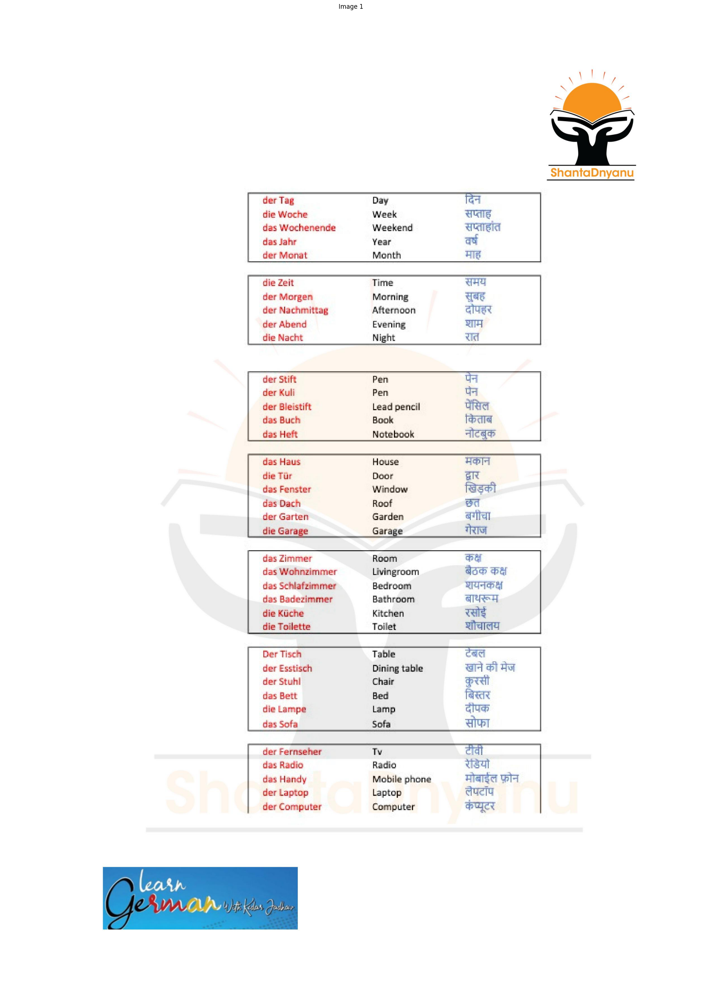

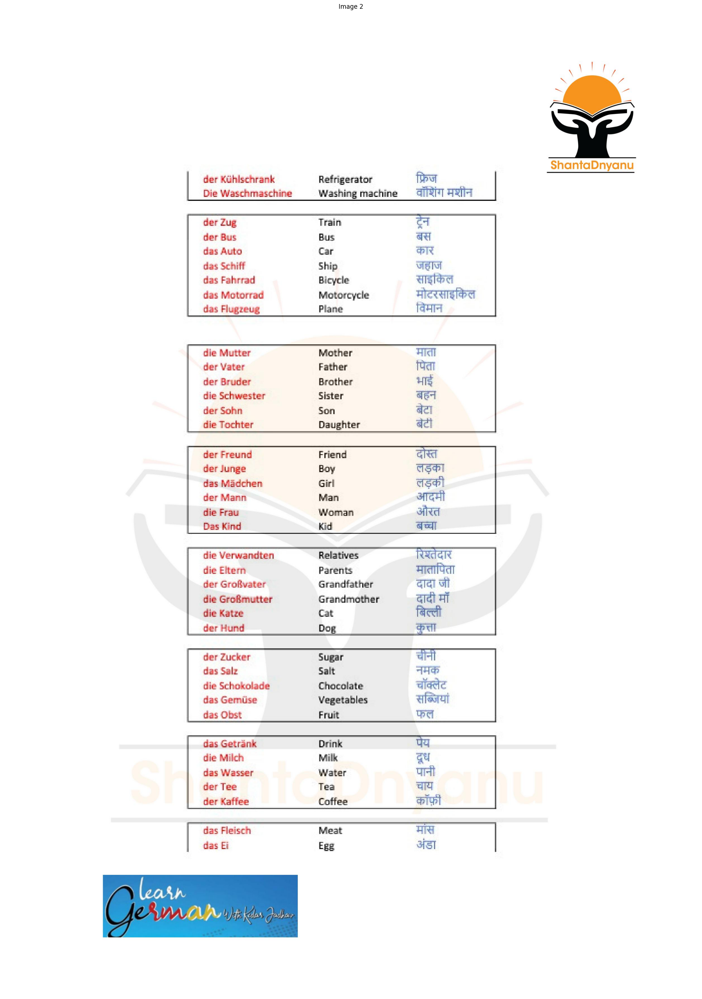

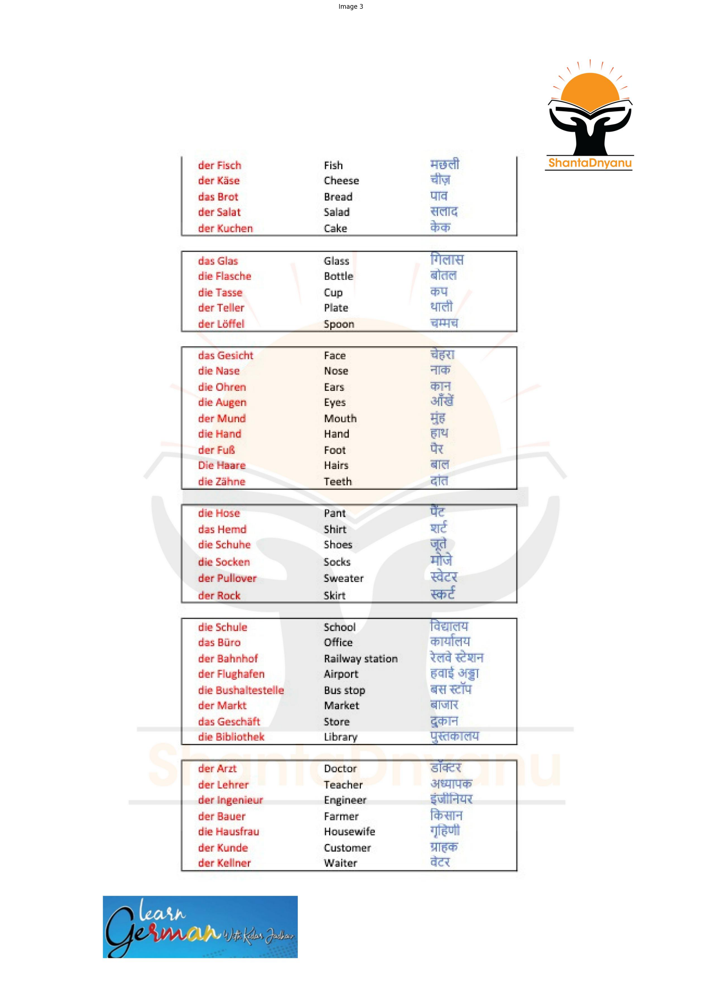

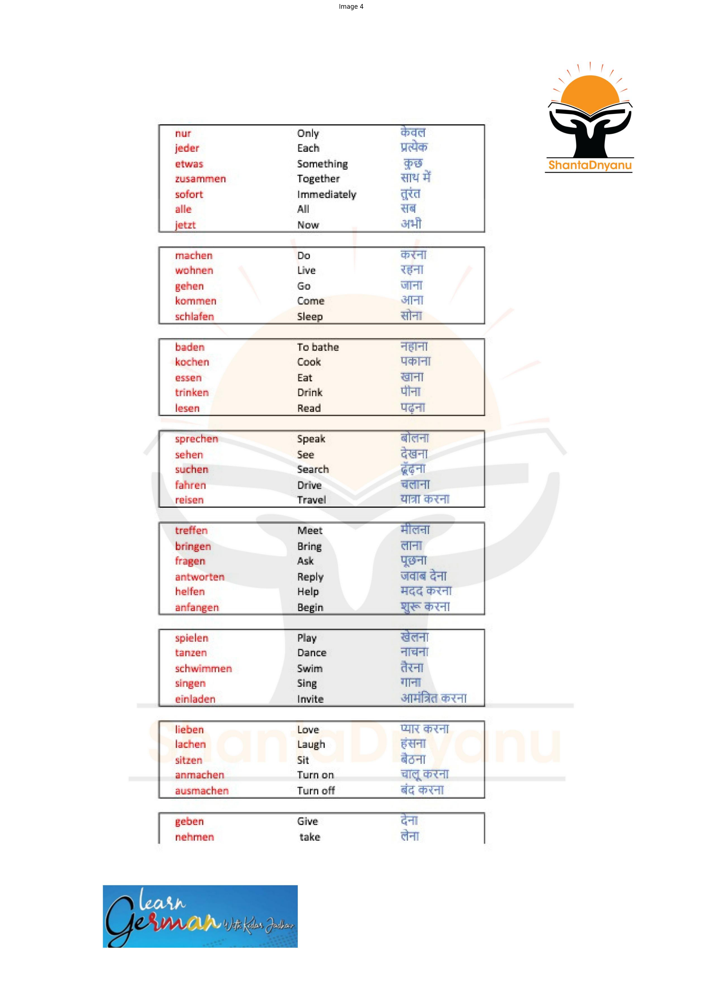

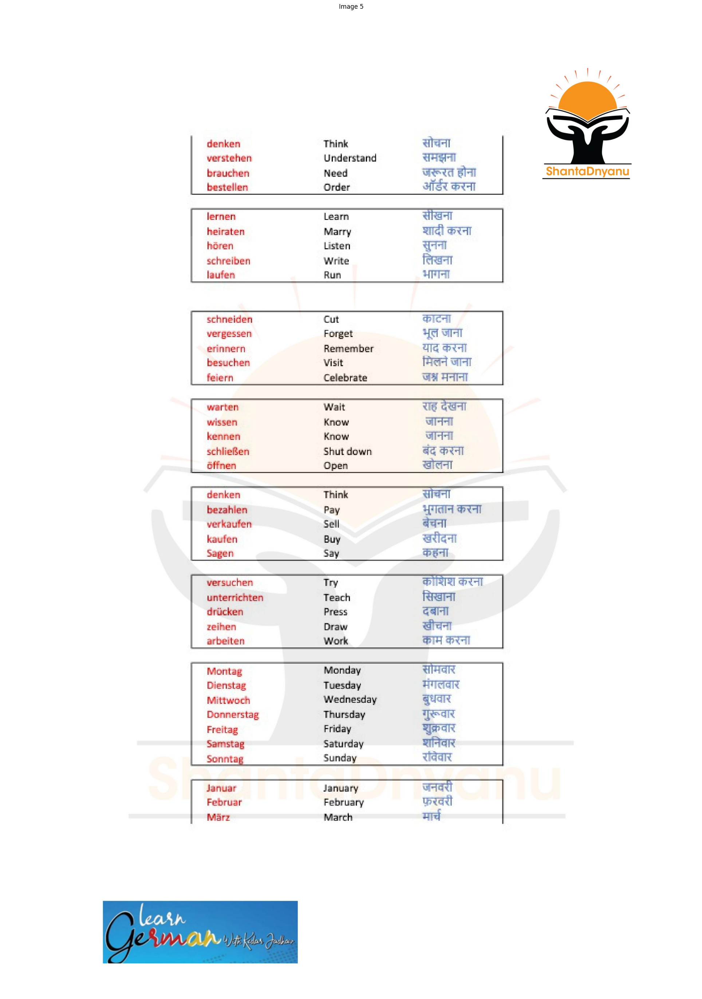

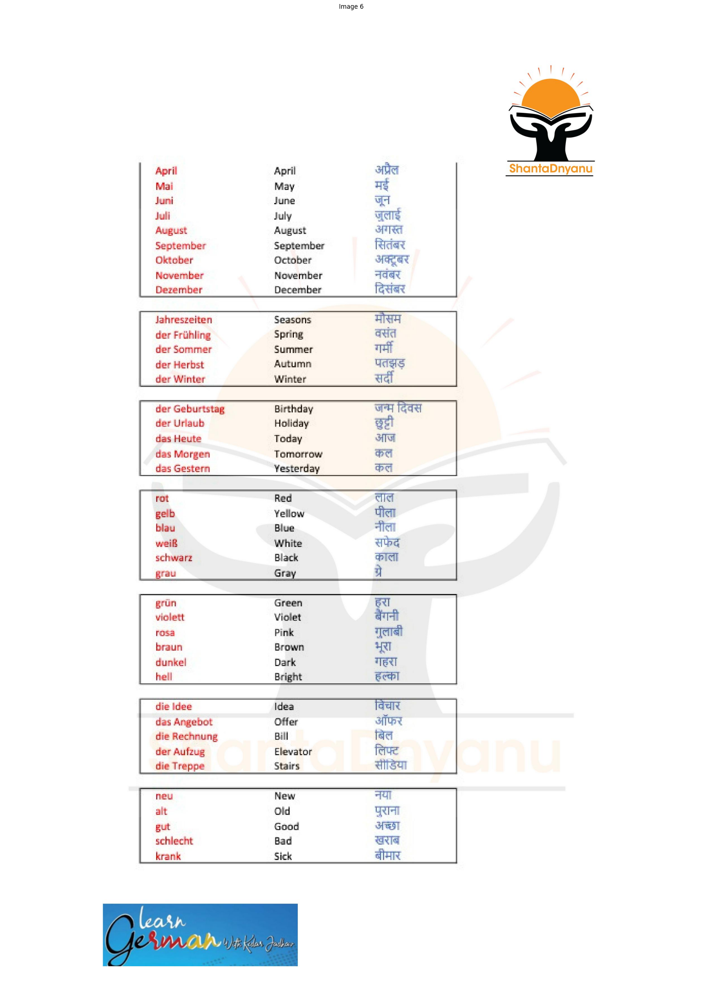

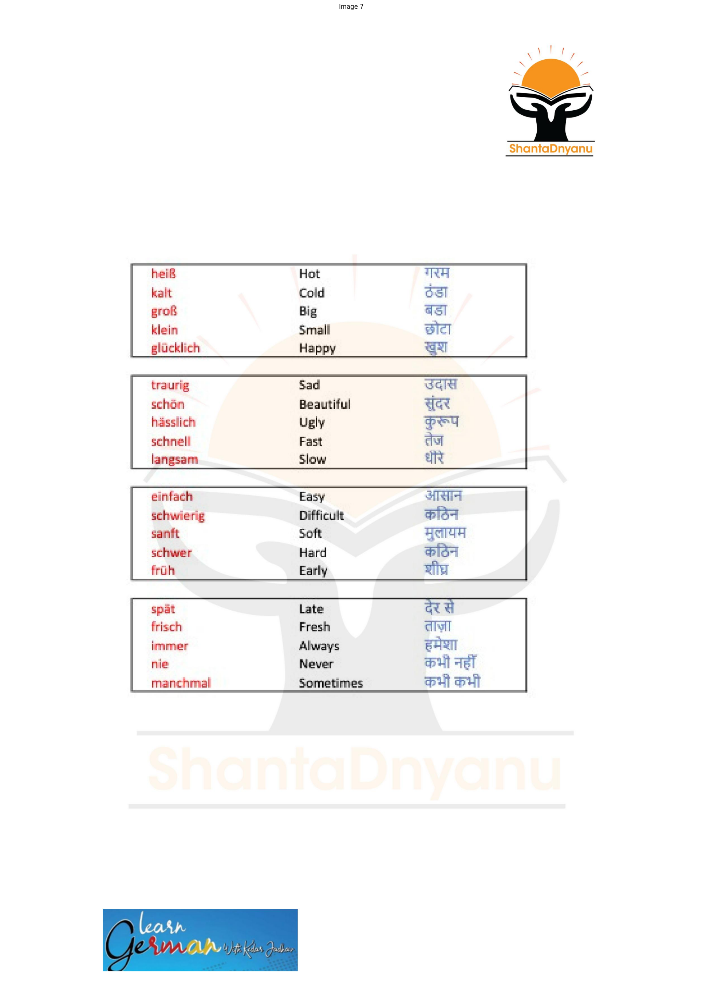

In [30]:
display_image(pdf_to_image_var)

## PyTesseract Library

In [37]:
! pip install pytesseract

In [38]:
!apt-get update
!apt-get install -y tesseract-ocr

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,105 kB]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,604 kB]
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:12 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:13 https://r2u.stat.illinois.edu/ubuntu jamm

In [39]:
import pytesseract

In [40]:
from pytesseract import image_to_string

In [35]:
def extract_text_with_pytesseract(list_of_images):

  image_data = [list(data.values())[0] for data in list_of_images]
  image_content = []

  for index, image_bytes in enumerate(image_data):

    image = Image.open(BytesIO(image_bytes))
    image_content.append(image_to_string(image))

  return "\n".join(image_content)

In [41]:
# test for pytesseract
extracted_text = extract_text_with_pytesseract(pdf_to_image_var)

print(extracted_text)

die Zeit

der Morgen
der Nachmittag
der Abend

die Nacht

der Stift
der Kuli

der Bleistift
das Buch
das Heft

das Zimmer

das Wohnzimmer
das Schlafzimmer
das Badezimmer
die Kiche

die Toilette

Der Tisch
der Esstisch
der Stuhl
das Bett
die Lampe
das Sofa

 

der Fernseher
das Radio

das Handy
der Laptop
der Computer

 

 

ShantaDnyanu

Time
Morning
Afternoon
Evening
Night

Pen

Pen

Lead pencil
Book
Notebook

Room
Livingroom
Bedroom
Bathroom
Kitchen
Toilet

Radia

Mobile phone
Laptop
Computer Pulet

       
 

 

ShantaDnyanu

der KGhischrank Refrigerator Tira
Die Waschmaschine Washing machine = G21 FRI

     

 

die Mutter

der Vater

der Bruder

die Schwester

der Sohn

die Tochter

der Freund Friend

der Junge Boy

das Madchen Girl

der Mann Man

die Frau Woman

Das Kind Kid

die Verwandten Relatives

die Eltern Parents

der Grakvater Grandfather
die Grokmutter Grandmother
die Katze Cat

der Hund Dog

der Zucker Sugar

das Salz Salt

die Schokolade Chocolate
das Gemiise Vegetabl

### It didn't give the expected outcome.

## PyPDF

In [44]:
!pip install PyPDF2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.6/232.6 kB 5.6 MB/s eta 0:00:00


In [45]:
import PyPDF2
from PyPDF2 import PdfReader

In [50]:
def extract_text_PyPDF(pdf_path):

  pdf_reader = PdfReader(pdf_path)
  raw_text = ""

  for i, page in enumerate(pdf_reader.pages):
    print(f"Extracting text from page {i + 1}")
    text = page.extract_text()
    print(text)

    if text:
      raw_text += text

  return text

In [52]:
# Executing PyPDF2
extracted_text = extract_text_PyPDF("/content/Lektion 11.pdf")

print(extracted_text)

Extracting text from page 1
Lektion 11
Extracting text from page 2
Verben 2
Zeitformen –das Präteritum von „haben“ und „sein“
sein haben
ich war hatte
du warst hattest
er/es/sie war hatte
wir waren hatten
ihr wart hattet
sie/Sie waren hattenDas Präteritum braucht man 
für schriftliche Texte. 
Mündlich braucht man es für 
die Verben „sein“ und 
„haben“.
(Wo warst du gestern? / Ich 
war im Krankenhaus. / Mein 
Sohn hatte einen Unfall .)
Vergangenheit : vor 5 Minuten, 
gestern, 
vor einer Woche, vor 5 Jahren, 
vor 100 Jahren, vor 50.000 
Jahren…
Zeitform:
Präteritum / PerfektGegenwart : 
jetzt, in diesem 
Moment
Zeitform:
Präsens
Extracting text from page 3
Verben
Zeitformen –das Präteritum der Modalverben
müssen können wollen dürfen sollen
ich musste konnte wollte durfte sollte
du musstest konntestwolltest durftest solltest
er/es/sie musste konnte wollte durfte sollte
wir mussten konnten wollten durften sollten
ihr musstet konntetwolltet durftet solltet
sie/Sie mussten konnten wollten du

## It also didn't work, because the file (image file converted to pdf)

## LangChain

1. Images
2. PDFs

In [53]:
!pip install langchain

In [59]:
!pip install langchain-community

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 43.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 62.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 408.7/408.7 kB 35.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 101.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.5/49.5 kB 4.7 MB/s eta 0:00:00
  Attempting uninstall: SQLAlchemy
    Found existing installation: SQLAlchemy 2.0.36
    Uninstalling SQLAlchemy-2.0.36:
      Successfully uninstalled SQLAlchemy-2.0.36
  Attempting uninstall: langchain-core
    Found existing installation: langchain-core 0.3.13
    Uninstalling langchain-core-0.3.13:
      Successfully uninstalled langchain-core-0.3.13
  Attempting uninstall: langchain
    Found existing installation: langchain 0.3.4
    Uninstalling langchain-0.3.4:
      Successfully uninstalled langchain-0.3.4


In [65]:
! pip install pdfminer

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 53.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pdfminer: filename=pdfminer-20191125-py3-none-any.whl size=6140064 sha256=83157d844b22cabeae1aa853a5d2620981ead4640a846272c8c29fee71087148
  Stored in directory: /root/.cache/pip/wheels/4e/c1/68/f7bd0a8f514661f76b5cbe3b5f76e0033d79f1296012cbbf72
Successfully built pdfminer


In [9]:
import langchain
from langchain import document_loaders
from langchain.document_loaders import image
from langchain.document_loaders.image import UnstructuredImageLoader

In [69]:
!pip install pdfminer.six


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 62.3 MB/s eta 0:00:00


In [6]:
from pdfminer.utils import open_filename

In [13]:
!pip install unstructured_inference

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 2.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.0/42.0 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.4/48.4 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 105.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.2/19.2 MB 86.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 92.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.2/59.2 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 103.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 7.9 MB/s eta 0:00:00
  Created wheel for iopath: filename=iopath-0.1.10-py3-none-any.whl size=31528 sha256=8a158f7ec8dceafc2ce67e4ecb5a4074481a7f6eed145a5eb434e5b748741084
  Stored in director

In [24]:
def extract_text_with_langchain_image(list_of_images):

  image_data = [list(data.values())[0] for data in list_of_images]
  image_content = []

  for index, image_bytes in enumerate(image_data):

    # image = Image.open(BytesIO(image_bytes))
    # loader = UnstructuredImageLoader(image)
    # Pass the raw bytes directly to UnstructuredImageLoader
    loader = UnstructuredImageLoader(BytesIO(image_bytes))
    data = loader.load()


    raw_text = data[index].page_content
    image_content.append(raw_text)

  return "\n".join(image_content)

In [25]:
extracted_text = extract_text_with_langchain_image(pdf_to_image_var)

print(extracted_text)

TypeError: stat: path should be string, bytes, os.PathLike or integer, not BytesIO

In [31]:
import tempfile
import os

def extract_text_with_langchain_image_updated(list_of_images):
    image_data = [list(data.values())[0] for data in list_of_images]
    image_content = []

    for image_bytes in image_data:
        # Use a temporary file to store the image bytes
        with tempfile.NamedTemporaryFile(delete=True, suffix='.jpeg') as temp_file:
            temp_file.write(image_bytes)
            temp_file.flush()  # Ensure the data is written to the file

            # Use the temporary file's name with the loader
            loader = UnstructuredImageLoader(temp_file.name)
            data = loader.load()

            # Assuming each image produces one document with content
            raw_text = data[0].page_content  # Adjust based on how data is structured
            image_content.append(raw_text)

    # Join and return all extracted content as a single string
    return "\n".join(image_content)

In [35]:
pdf_to_image_var = pdf_to_image("/content/Lektion 11.pdf")

In [36]:
extracted_text = extract_text_with_langchain_image_updated(pdf_to_image_var)

print(extracted_text)

ERROR:unstructured:Failed to get OCRAgent instance: No module named 'unstructured_pytesseract'


RuntimeError: Could not get the OCRAgent instance. Please check the OCR package and the OCR_AGENT environment variable.

In [34]:
!pip install pytesseract
!pip install unstructured
!apt-get install -y tesseract-ocr
!tesseract --version

import pytesseract
pytesseract.pytesseract.tesseract_cmd = '/usr/bin/tesseract'

# Now, run your text extraction code
extracted_text = extract_text_with_langchain_image(pdf_to_image_var)
print(extracted_text)

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 52 not upgraded.
tesseract 4.1.1
 leptonica-1.82.0
  libgif 5.1.9 : libjpeg 8d (libjpeg-turbo 2.1.1) : libpng 1.6.37 : libtiff 4.3.0 : zlib 1.2.11 : libwebp 1.2.2 : libopenjp2 2.4.0
 Found AVX512BW
 Found AVX512F
 Found AVX2
 Found AVX
 Found FMA
 Found SSE
 Found libarchive 3.6.0 zlib/1.2.11 liblzma/5.2.5 bz2lib/1.0.8 liblz4/1.9.3 libzstd/1.4.8


TypeError: stat: path should be string, bytes, os.PathLike or integer, not BytesIO

In [40]:
# Function to convert PDF to images
def pdf_to_image(pdf_path, scale=300/72):
    # Read the content using PdfDocument
    pdf_file = pdfium.PdfDocument(pdf_path)
    page_indices = [i for i in range(len(pdf_file))]

    # Render the PDF pages as images
    renderer = pdf_file.render(
        pdfium.PdfBitmap.to_pil,
        page_indices=page_indices,
        scale=scale,
    )

    # Create a list of dictionaries containing image bytes
    final_list = []
    for i, image in zip(page_indices, renderer):
        image_byte_array = BytesIO()
        image.save(image_byte_array, format='jpeg', optimize=True)
        image_byte_array = image_byte_array.getvalue()
        final_list.append({i: image_byte_array})

    return final_list

# Function to extract text using LangChain
def extract_text_with_langchain_image(list_of_images):
    image_data = [list(data.values())[0] for data in list_of_images]
    image_content = []

    for image_bytes in image_data:
        # Use a temporary file to store the image bytes
        with tempfile.NamedTemporaryFile(delete=True, suffix='.jpeg') as temp_file:
            temp_file.write(image_bytes)
            temp_file.flush()  # Ensure the data is written to the file

            # Use the temporary file's name with the loader
            loader = UnstructuredImageLoader(temp_file.name)
            data = loader.load()

            # Assuming each image produces one document with content
            raw_text = data[0].page_content  # Adjust based on how data is structured
            image_content.append(raw_text)

    # Join and return all extracted content as a single string
    return "\n".join(image_content)

# Main function to run the extraction process
def main(pdf_path):
    # Convert PDF to images
    pdf_images = pdf_to_image(pdf_path)

    # Extract text from images using LangChain
    extracted_text = extract_text_with_langchain_image(pdf_images)

    # Print the extracted text
    print(extracted_text)

# Example usage: Specify your PDF path here
pdf_path = '/content/Lektion 11.pdf'  # Replace with your actual PDF file path
main(pdf_path)

ERROR:unstructured:Failed to get OCRAgent instance: No module named 'unstructured_pytesseract'


RuntimeError: Could not get the OCRAgent instance. Please check the OCR package and the OCR_AGENT environment variable.

In [38]:
!sudo apt-get install tesseract-ocr-eng
!sudo apt-get install tesseract-ocr-deu

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr-eng is already the newest version (1:4.00~git30-7274cfa-1.1).
tesseract-ocr-eng set to manually installed.
0 upgraded, 0 newly installed, 0 to remove and 52 not upgraded.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  tesseract-ocr-deu
0 upgraded, 1 newly installed, 0 to remove and 52 not upgraded.
Need to get 744 kB of archives.
After this operation, 1,540 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-deu all 1:4.00~git30-7274cfa-1.1 [744 kB]
Fetched 744 kB in 1s (677 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to fr